In [3]:
%load_ext autoreload
%autoreload 2
import cv2
import sys
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
import os
from PIL import Image
import plotly.graph_objects as go

from sklearn.cluster import DBSCAN

# Hack the path for now, deal with this later
cwd = '/teamspace/studios/this_studio/letsdoit'
if (cwd not in sys.path):
    sys.path.append(cwd)
sys.path.append(os.path.dirname(cwd))

from masks_finder import MasksFinder, unrotate_masks, unrotate_bboxes
from masks_matcher import MasksMatcher
from clip_retriever import ClipRetriever
from masks_merger import MasksMerger
from dataloader.dataloader import DataLoader
from object_scorer import ObjectScorer
from letsdoit.utils.object_instance import ObjectInstance, initialize_object_instances, plot_instances_3d, generate_masks_features
from letsdoit.utils.misc import select_ids
from letsdoit.utils.object_3d import plot_objects_3d

import GroundingDINO.groundingdino.datasets.transforms as T

from transformers import CLIPProcessor, CLIPModel
import scipy
from torch.nn import CosineSimilarity

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


### Paths

In [4]:
path_dataset = '/teamspace/studios/this_studio/datasets'

### Initialize things

In [ ]:
loader = DataLoader(path_dataset, split='dev')

In [4]:
retriever = ClipRetriever()
masks_finder = MasksFinder()


clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3549.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


final text_encoder_type: bert-base-uncased


Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.bias', 'cls.seq_relationship.weight', 'cls.predictions.transform.dense.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


_IncompatibleKeys(missing_keys=[], unexpected_keys=['label_enc.weight'])
<All keys matched successfully>


In [5]:
ASSET_TYPE = 'wide'

### Functions

In [6]:
def select_ids(array, ids):
    return [array[idx] for idx in ids]


## Pipeline

In [7]:
visit_ids = loader.visit_ids
video_ids = loader.get_video_ids(visit_ids[0])

visit_id = visit_ids[0]
video_id = video_ids[0]

In [8]:
# Get both original and upright-rotated images and depths as outputs
images, images_rotated, image_paths, intrinsics, poses, orientations = loader.get_images(visit_id, video_id, asset_type=ASSET_TYPE, sample_freq=1)
depths, depths_rotated, depth_paths, _, _, _ = loader.get_depths(visit_id, video_id, asset_type=ASSET_TYPE, sample_freq=1)

Loading rgb frames from visit 420683 and video 42445132:   0%|          | 0/159 [00:00<?, ?it/s]

Loading rgb frames from visit 420683 and video 42445132: 100%|██████████| 159/159 [00:07<00:00, 20.62it/s]
Loading depth frames from visit 420683 and video 42445132: 100%|██████████| 159/159 [00:05<00:00, 27.65it/s]


In [9]:
retriever.generate_image_features(images_rotated)

In [10]:
retriever.image_features[0].shape

torch.Size([512])

In [11]:
# For an object, get a list of corresponding ObjectInstances
object = 'drawer'
best_indices = retriever.retrieve_best_images_for_object(object, topk=10, max_similarity_thresh=0.95)

In [12]:
best_images = select_ids(images, best_indices)
best_images_rotated = select_ids(images_rotated, best_indices)
best_image_paths = select_ids(image_paths, best_indices)
best_intrinsics = select_ids(intrinsics, best_indices)
best_poses = select_ids(poses, best_indices)
best_orientations = select_ids(orientations, best_indices)
best_depths = select_ids(depths, best_indices)
best_depth_paths = select_ids(depth_paths, best_indices)

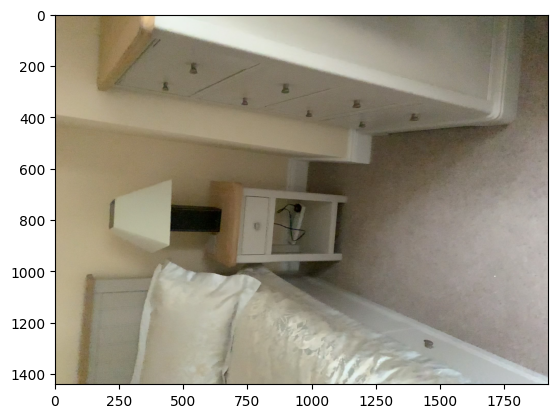

In [13]:
plt.imshow(best_images[3])

In [14]:
# Masks we get here as outputs are for the upright-rotated images
image_ids, masks, bboxes, confidences, labels = masks_finder.get_masks_from_imgs(best_images_rotated, object)

  0%|          | 0/10 [00:00<?, ?it/s]/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/transformers/modeling_utils.py:768: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(


/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/torch/utils/checkpoint.py:460: UserWarning: torch.utils.checkpoint: please pass in use_reentrant=True or use_reentrant=False explicitly. The default value of use_reentrant will be updated to be False in the future. To maintain current behavior, pass use_reentrant=True. It is recommended that you use use_reentrant=False. Refer to docs for more details on the differences between the two variants.
  warnings.warn(
/home/zeus/miniconda3/envs/cloudspace/lib/python3.10/site-packages/torch/utils/checkpoint.py:90: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn(
100%|██████████| 10/10 [00:12<00:00,  1.25s/it]


In [15]:
# Rotate masks and bboxes back to the rotation of the original image
mask_image_sizes = [best_images_rotated[idx].shape[:-1] for idx in image_ids]
mask_image_orientations = [best_orientations[idx] for idx in image_ids]
masks_unrotated = unrotate_masks(masks=masks, orientations=orientations)
bboxes_unrotated = unrotate_bboxes(bboxes=bboxes, img_dims=mask_image_sizes, orientations=mask_image_orientations)

In [16]:
image_features = generate_masks_features(clip_processor, clip_model, select_ids(best_images_rotated, image_ids), bboxes, masks)

In [17]:
dict_object_instances = {'images': select_ids(best_images, image_ids),
                         'image_names': [Path(img_path).name.replace('.png', '') for img_path in select_ids(best_image_paths, image_ids)],
                         'depths': select_ids(best_depths, image_ids),
                         'bboxes': bboxes_unrotated,
                         'masks': masks_unrotated,
                         'labels': labels,
                         'confidences': confidences,
                         'intrinsics': select_ids(best_intrinsics, image_ids),
                         'extrinsics': select_ids(best_poses, image_ids),
                         'orientations': select_ids(best_orientations, image_ids),
                         'image_features': image_features}

object_instances = initialize_object_instances(**dict_object_instances)

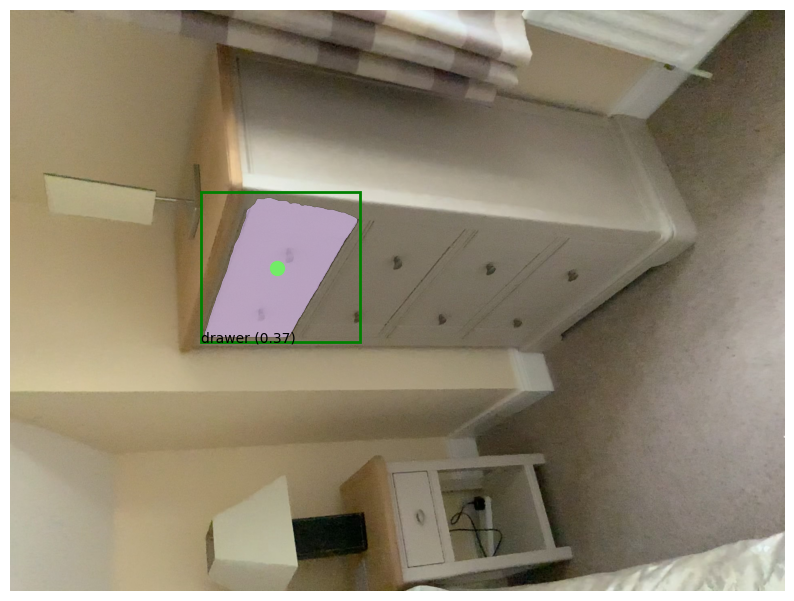

In [18]:
object_instances[3].plot_2d()

In [19]:
plot_instances_3d(object_instances[:], subsample=True)

### Masks Matching

In [69]:
masks_merger = MasksMerger(geo_similarity_thresh=0.7)

In [70]:
objects_3d = masks_merger(object_instances)

Matching the object instances:   0%|          | 0/25 [00:00<?, ?it/s]

Matching the object instances: 100%|██████████| 25/25 [00:21<00:00,  1.19it/s]


In [71]:
plot_objects_3d(objects_3d)